In [0]:
%pip install xgboost

Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.1/297.1 MB 3.5 MB/s eta 0:00:00
Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.


In [0]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from pyspark.sql import functions as F
import pandas as pd

In [0]:
from sklearn.preprocessing import LabelEncoder

In [0]:
dbutils.fs.ls("/mnt/ainavigatorpath/")

[FileInfo(path='dbfs:/mnt/ainavigatorpath/ai_hackathon_data-v2.csv', name='ai_hackathon_data-v2.csv', size=162673763, modificationTime=1717834094000),
 FileInfo(path='dbfs:/mnt/ainavigatorpath/rank_wise_bh.csv', name='rank_wise_bh.csv', size=1286671, modificationTime=1717755969000)]

In [0]:
df = spark.read.format("csv").option("header", True).load("dbfs:/mnt/ainavigatorpath/ai_hackathon_data-v2.csv")


In [0]:
from pyspark.sql import functions as F
df_n_full = df.withColumn("pnr_creation_datetime1",F.to_timestamp("pnr_creation_dateTime", "yyyy-MM-dd'T'HH:mm:ss'Z'") ).withColumn("ticket_issue_date1",F.to_timestamp("ticket_issue_date", "yyyy-MM-dd") )
df_n_full_pos = df_n_full.withColumn("date_diff", F.date_diff("ticket_issue_date1","pnr_creation_datetime1"))
df_p = df_n_full_pos.filter(F.col("date_diff")>=0).drop("date_diff","ticket_issue_date1","pnr_creation_datetime1")
df_n = df_n_full_pos.filter(F.col("date_diff")<0)

In [0]:
df_p.createOrReplaceTempView("ai_hackathon_data_v1")
spark.sql("CREATE or Replace TABLE ai_hackathon_data_v1 USING delta AS SELECT * FROM ai_hackathon_data_v1")

DataFrame[num_affected_rows: bigint, num_inserted_rows: bigint]

In [0]:
%sql
select * from ai_hackathon_data_v1

mask_pnr,pnr_creation_dateTime,pnr_keywords_code,pnr_keywords_text,ticket_issue_date,TTL_Date,pnr_AutomatedProcesses_code,cancellation_Date,Number_of_PAX,Booking_System_Code,agent_type,pnr_creation_pointOfSale_office_id,segid,Marketing_Airline_Code,Marketing_Flight_Number,Op_Airline_Code,Op_flightNumber,RBD,no_days_ticked_TTL_bf_exp,no_days_cancel_TTL_bf_exp,no_days_cancel_TTL_af_bking,no_days_cancel_bf_std,Cancelling_close_TTL_exp,agency_behavour
10CD20717,2023-10-23T12:46:00Z,TLEX,TO BOOKING,2023-10-24,2024-03-22T21:00:00,OPC,null,2,1G,TRAVEL_AGENT,M8F,6,EY,124,null,null,E,150,null,null,null,Yes,ticketed
10EE1079,2023-03-16T10:30:00Z,null,TO BOOKING,2023-03-21,2023-06-15T19:50:00,OPC,null,3,1S,null,2OUI,2,EY,404,null,null,K,86,null,null,null,Yes,ticketed
10FD23219,2023-12-19T10:17:00Z,TLEX,TO BOOKING,2023-12-22,2024-02-14T03:22:00,OPC,2024-01-31T23:59:00,2,1A,TRAVEL_AGENT,MILIG2578,3,EY,831,null,null,U,54,14,43,null,Yes,ticketed
10F10G1416,2023-10-04T08:55:00Z,TLEX,TO BOOKING,2023-10-09,2024-02-10T19:01:00,OPC,null,2,1G,TRAVEL_AGENT,50PF,6,EY,31,null,null,Q,124,null,null,null,Yes,ticketed
10GIC2632,2022-12-14T11:19:00Z,null,TO BOOKING,2022-12-23,null,null,null,2,1A,null,BRELT215M,3,EY,431,null,null,D,null,null,null,null,No,ticketed
10J3D425,2023-10-23T14:32:00Z,TLEX,TO BOOKING,2023-11-29,2024-04-21T01:50:00,OPC,null,2,1A,TRAVEL_AGENT,FRADR22KH,2,EY,432,null,null,E,144,null,null,null,Yes,ticketed
10J9GG16,2023-11-30T18:01:00Z,null,TO BOOKING,2023-12-12,2024-05-04T04:46:00,OPC,null,1,1G,TRAVEL_AGENT,3B18,1,EY,86,null,null,V,144,null,null,null,Yes,ticketed
10J9GG16,2023-11-30T18:01:00Z,null,TO BOOKING,2023-12-12,2024-05-03T18:41:00,OPC,null,1,1G,TRAVEL_AGENT,3B18,1,EY,86,null,null,V,143,null,null,null,Yes,ticketed
101221201827,2023-11-21T07:56:00Z,TLEX,TO BOOKING,2023-11-23,2023-12-03T02:14:00,OPC,null,3,1A,TRAVEL_AGENT,BRELT21BG,2,EY,73,null,null,E,10,null,null,null,Yes,ticketed
10122127I19,2023-06-03T12:30:00Z,TLEX,TO BOOKING,2023-08-21,2023-09-01T11:15:00,OPC,null,1,1A,TRAVEL_AGENT,BERAE2050,2,EY,878,null,null,K,11,null,null,null,Yes,ticketed


#Label Encoding

#Prep Training Data

In [0]:
df_base = spark.sql("select * from ai_hackathon_data_v1")


In [0]:
from datetime import date
date_var = date(2023, 12, 31)
print(date_var)
df_base_before = df_base.filter(F.col("pnr_creation_dateTime")<= date_var )


2023-12-31


In [0]:
df_base_pd = pd.DataFrame(df_base_before.toPandas())
# df_reverse_encode = df_base_pd["agency_behavour"]
# df_reverse_encode = df_reverse_encode.rename('agency_behavour_base')
# df_reverse_encode_f = df_reverse_encode.to_frame()
# df_reverse_encode_f


In [0]:

# df = pd.DataFrame(data) 

import pandas as pd
from sklearn.preprocessing import LabelEncoder

df = pd.DataFrame(df_base_pd)

# Print original DataFrameprint("Original DataFrame:")
print(df) 
# df.dtypes

encoding_mapping = {}
# Initialize LabelEncoder
label_encoder = LabelEncoder() 
#  Fit and transform the  data  pd.DataFrame(df_standard_scaled, columns=df.columns)
for i in df.columns:
    df[i] = label_encoder.fit_transform(df[i]) 
    encoding_mapping[i] = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
 # Print the DataFrame with encoded values
print("DataFrame with Encoded Education Levels:")
print(df)


            mask_pnr  ... agency_behavour
0          10CD20717  ...        ticketed
1           10EE1079  ...        ticketed
2          10FD23219  ...        ticketed
3         10F10G1416  ...        ticketed
4          10GIC2632  ...        ticketed
...              ...  ...             ...
761128     23916H632  ...        ticketed
761129   2311I142714  ...        ticketed
761130   2313D251315  ...        ticketed
761131   23185282611  ...        ticketed
761132  231812132416  ...        ticketed

[761133 rows x 24 columns]
DataFrame with Encoded Education Levels:
        mask_pnr  ...  agency_behavour
0           2646  ...                4
1           2881  ...                4
2           3007  ...                4
3           2911  ...                4
4           3141  ...                4
...          ...  ...              ...
761128     50791  ...                4
761129     48000  ...                4
761130     48249  ...                4
761131     48812  ...                

## Feature Scaling

In [0]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler, MaxAbsScaler, RobustScaler
 
# # Sample DataFrame
# data = {'Feature1': [10, 20, 30, 40, 50],
#         'Feature2': [100, 200, 300, 400, 500],
#         'Feature3': [1000, 2000, 3000, 4000, 5000]}
df = pd.DataFrame(df)
 
# print("Original DataFrame:")
# print(df)
 
# RobustScaler
robust_scaler = RobustScaler()
df_robust_scaled = robust_scaler.fit_transform(df)   #df_base_train_data_pd
df_robust_scaled = pd.DataFrame(df_robust_scaled, columns=df.columns)
# print("Robust Scaled DataFrame:")
# print(df_robust_scaled)

In [0]:
df_robust_scaled_train_x =  df_robust_scaled.drop("agency_behavour", axis= 1)
df_robust_scaled_train_y =  df_robust_scaled["agency_behavour"]

#Prep Test Data

In [0]:
df_base_after = df_base.filter(F.col("pnr_creation_dateTime")> date_var )

In [0]:

df_base_pd = df_base_after.toPandas()


# df = pd.DataFrame(data) 

import pandas as pd
from sklearn.preprocessing import LabelEncoder

df = pd.DataFrame(df_base_pd) 
# Print original DataFrameprint("Original DataFrame:")
# print(df) 
# Initialize LabelEncoder
label_encoder = LabelEncoder() 
#  Fit and transform the  data  pd.DataFrame(df_standard_scaled, columns=df.columns)
for i in df.columns:
    df[i] = label_encoder.fit_transform(df[i]) 
 # Print the DataFrame with encoded values

# # df["agency_behavour_l"] = df["agency_behavour"]
# print("DataFrame with Encoded Education Levels:")
# print(df)


import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler, MaxAbsScaler, RobustScaler
 
# # Sample DataFrame
# data = {'Feature1': [10, 20, 30, 40, 50],
#         'Feature2': [100, 200, 300, 400, 500],
#         'Feature3': [1000, 2000, 3000, 4000, 5000]}
df_base_test_data_pd = df
df = pd.DataFrame(df_base_test_data_pd)
 
# print("Original DataFrame:")
# print(df)

robust_scaler = RobustScaler()
df_robust_scaled_test = robust_scaler.fit_transform(df)
df_robust_scaled_test = pd.DataFrame(df_robust_scaled_test, columns=df.columns)
# print("Robust Scaled DataFrame:")
# print(df_robust_scaled_test)


df_robust_scaled_test_x =  df_robust_scaled_test.drop("agency_behavour", axis= 1)
df_robust_scaled_test_y =  df_robust_scaled_test["agency_behavour"]


#Model Exploration

In [0]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
# Define models
models = {
    'Logistic Regression': LogisticRegression(max_iter=100),
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier()
    # 'XGBoost': XGBClassifier()
    # 'Support Vector Machine': SVC(max_iter=100),
    # 'k-Nearest Neighbors': KNeighborsClassifier()
}



 
X_train = df_robust_scaled_train_x
y_train = df_robust_scaled_train_y
X_test = df_robust_scaled_test_x
y_test = df_robust_scaled_test_y


# Train and evaluate models
results = {}
for name, model in models.items():
    try:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        results[name] = {
            'Accuracy': accuracy_score(y_test, y_pred),
            'Precision': precision_score(y_test, y_pred, average='weighted'),
            'Recall': recall_score(y_test, y_pred, average='weighted'),
            'F1 Score': f1_score(y_test, y_pred, average='weighted'),
            'model': model,
            'y_pred' :  y_pred

        }
        print(f"passed for {name}")
    except:
        print(f"failing in {name}")
 
# Display results
results_df = pd.DataFrame(results)
print(results_df)

/databricks/python/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


passed for Logistic Regression
passed for Decision Tree
passed for Random Forest
                                         Logistic Regression  ...                                      Random Forest
Accuracy                                            0.807722  ...                                           0.823484
Precision                                           0.717959  ...                                           0.799002
Recall                                              0.807722  ...                                           0.823484
F1 Score                                            0.740158  ...                                           0.753245
model                                   LogisticRegression()  ...  (DecisionTreeClassifier(max_features='sqrt', r...
y_pred     [0.0, 0.0, -4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...  ...  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...

[6 rows x 3 columns]


In [0]:
results_df

,Logistic Regression,Decision Tree,Random Forest
Accuracy,0.807722,0.791985,0.823484
Precision,0.717959,0.762804,0.799002
Recall,0.807722,0.791985,0.823484
F1 Score,0.740158,0.774254,0.753245
model,LogisticRegression(),DecisionTreeClassifier(),"(DecisionTreeClassifier(max_features='sqrt', r..."
y_pred,"[0.0, 0.0, -4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [0]:
df_adding = [row for row in df_base_after.collect()]

list_of_lists = [[value for value in row] for row in df_base_after.collect()]

In [0]:
from pyspark.sql.types import StructType,StructField,StringType,DateType,TimestampType,IntegerType,DecimalType,DoubleType,LongType,FloatType

up_schema = StructType([StructField('mask_pnr', StringType(), True), StructField('pnr_creation_dateTime', StringType(), True), StructField('pnr_keywords_code', StringType(), True), StructField('pnr_keywords_text', StringType(), True), StructField('ticket_issue_date', StringType(), True), StructField('TTL_Date', StringType(), True), StructField('pnr_AutomatedProcesses_code', StringType(), True), StructField('cancellation_Date', StringType(), True), StructField('Number_of_PAX', StringType(), True), StructField('Booking_System_Code', StringType(), True), StructField('agent_type', StringType(), True), StructField('pnr_creation_pointOfSale_office_id', StringType(), True), StructField('segid', StringType(), True), StructField('Marketing_Airline_Code', StringType(), True), StructField('Marketing_Flight_Number', StringType(), True), StructField('Op_Airline_Code', StringType(), True), StructField('Op_flightNumber', StringType(), True), StructField('RBD', StringType(), True), StructField('no_days_ticked_TTL_bf_exp', StringType(), True), StructField('no_days_cancel_TTL_bf_exp', StringType(), True), StructField('no_days_cancel_TTL_af_bking', StringType(), True), StructField('no_days_cancel_bf_std', StringType(), True), StructField('Cancelling_close_TTL_exp', StringType(), True), StructField('agency_behavour', StringType(), True), StructField('agency_behavour_y_predict', StringType(), True)])

In [0]:
y_p_value =  results['Random Forest']['y_pred']
for i in range(len(y_p_value)):
    list_of_lists[i].append(str(y_p_value[i]))



In [0]:
df_final = spark.createDataFrame(data = list_of_lists,schema = up_schema)
df_final.display()

mask_pnr,pnr_creation_dateTime,pnr_keywords_code,pnr_keywords_text,ticket_issue_date,TTL_Date,pnr_AutomatedProcesses_code,cancellation_Date,Number_of_PAX,Booking_System_Code,agent_type,pnr_creation_pointOfSale_office_id,segid,Marketing_Airline_Code,Marketing_Flight_Number,Op_Airline_Code,Op_flightNumber,RBD,no_days_ticked_TTL_bf_exp,no_days_cancel_TTL_bf_exp,no_days_cancel_TTL_af_bking,no_days_cancel_bf_std,Cancelling_close_TTL_exp,agency_behavour,agency_behavour_y_predict
10162028729,2024-01-02T13:19:00Z,TLEX,TO BOOKING,2024-01-31,2024-02-11T21:15:00,OPC,null,3,1A,TRAVEL_AGENT,FRADR22KH,3,EY,431,null,null,M,11,null,null,null,Yes,ticketed,0.0
101625H21I,2024-02-08T15:29:00Z,null,TO BOOKING,2024-02-16,2024-03-09T16:27:00,OPC,null,2,1A,null,MUCF721SZ,5,EY,431,null,null,M,22,null,null,null,Yes,ticketed,0.0
1023J41320,2024-05-16T22:43:00Z,TLEX,TO BOOKING,2024-05-17,2024-06-17T22:20:00,OPC,null,1,1G,TRAVEL_AGENT,36PR,5,EY,5902,AF,639,Q,31,null,null,null,Yes,ticketed,0.0
10278201124,2024-04-23T19:34:00Z,TLEX,TO BOOKING,2024-04-26,2024-04-26T21:34:00,OPC,null,2,1A,null,MUCF721SZ,3,EY,85,null,null,E,0,null,null,null,No,ticketed,0.0
11H1119229,2024-01-16T15:47:00Z,null,TO BOOKING,2024-01-24,2024-02-05T16:45:00,OPC,2024-02-14T00:00:00,2,1A,TRAVEL_AGENT,MILIG3513,4,EY,81,null,null,L,12,-9,29,null,Yes,cancel earlier than 7days,0.0
1119156921,2024-04-05T12:28:00Z,TLEX,TO BOOKING,2024-04-09,2024-04-13T09:10:00,OPC,null,2,1G,TRAVEL_AGENT,3GC,4,EY,15,null,null,L,4,null,null,null,Yes,ticketed,0.0
12F492713,2024-01-30T21:06:00Z,TLEX,TO BOOKING,2024-01-31,2024-03-01T10:20:00,OPC,null,4,1A,null,ZRHC22111,1,EY,74,null,null,L,30,null,null,null,Yes,ticketed,0.0
1217918225,2024-03-08T13:09:00Z,TLEX,TO BOOKING,2024-03-12,2024-07-13T11:15:00,OPC,null,2,1G,TRAVEL_AGENT,680I,2,EY,878,null,null,Q,123,null,null,null,Yes,ticketed,0.0
1217918225,2024-03-08T13:09:00Z,TLEX,TO BOOKING,2024-03-12,2024-03-31T10:39:00,OPC,null,2,1G,TRAVEL_AGENT,680I,2,EY,878,null,null,Q,19,null,null,null,Yes,ticketed,0.0
122417121911,2024-01-03T07:09:00Z,TLEX,TO BOOKING,2024-03-19,2024-03-20T10:15:00,OPC,null,4,1A,TRAVEL_AGENT,BSLC228FT,1,EY,74,null,null,E,1,null,null,null,No,ticketed,0.0


In [0]:
df_final_full = df_final.withColumn("derived_col_predict", F.when(F.col("agency_behavour_y_predict") == '0.0',"ticketed").when(F.col("agency_behavour_y_predict") == '-4.0',"auto cancel").when(F.col("agency_behavour_y_predict") == '-1.0',"cancel earlier than 7days").when(F.col("agency_behavour_y_predict") == '-2.0',"cancel 1-3 day of exp").when(F.col("agency_behavour_y_predict") == '1.0',"ticketed and cancelled").when(F.col("agency_behavour_y_predict") == '-3.0',"average").when(F.col("agency_behavour_y_predict") == '2.0',"None").otherwise("unmapped"))

df_final_full.display()

mask_pnr,pnr_creation_dateTime,pnr_keywords_code,pnr_keywords_text,ticket_issue_date,TTL_Date,pnr_AutomatedProcesses_code,cancellation_Date,Number_of_PAX,Booking_System_Code,agent_type,pnr_creation_pointOfSale_office_id,segid,Marketing_Airline_Code,Marketing_Flight_Number,Op_Airline_Code,Op_flightNumber,RBD,no_days_ticked_TTL_bf_exp,no_days_cancel_TTL_bf_exp,no_days_cancel_TTL_af_bking,no_days_cancel_bf_std,Cancelling_close_TTL_exp,agency_behavour,agency_behavour_y_predict,derived_col_predict
10162028729,2024-01-02T13:19:00Z,TLEX,TO BOOKING,2024-01-31,2024-02-11T21:15:00,OPC,null,3,1A,TRAVEL_AGENT,FRADR22KH,3,EY,431,null,null,M,11,null,null,null,Yes,ticketed,0.0,ticketed
101625H21I,2024-02-08T15:29:00Z,null,TO BOOKING,2024-02-16,2024-03-09T16:27:00,OPC,null,2,1A,null,MUCF721SZ,5,EY,431,null,null,M,22,null,null,null,Yes,ticketed,0.0,ticketed
1023J41320,2024-05-16T22:43:00Z,TLEX,TO BOOKING,2024-05-17,2024-06-17T22:20:00,OPC,null,1,1G,TRAVEL_AGENT,36PR,5,EY,5902,AF,639,Q,31,null,null,null,Yes,ticketed,0.0,ticketed
10278201124,2024-04-23T19:34:00Z,TLEX,TO BOOKING,2024-04-26,2024-04-26T21:34:00,OPC,null,2,1A,null,MUCF721SZ,3,EY,85,null,null,E,0,null,null,null,No,ticketed,0.0,ticketed
11H1119229,2024-01-16T15:47:00Z,null,TO BOOKING,2024-01-24,2024-02-05T16:45:00,OPC,2024-02-14T00:00:00,2,1A,TRAVEL_AGENT,MILIG3513,4,EY,81,null,null,L,12,-9,29,null,Yes,cancel earlier than 7days,0.0,ticketed
1119156921,2024-04-05T12:28:00Z,TLEX,TO BOOKING,2024-04-09,2024-04-13T09:10:00,OPC,null,2,1G,TRAVEL_AGENT,3GC,4,EY,15,null,null,L,4,null,null,null,Yes,ticketed,0.0,ticketed
12F492713,2024-01-30T21:06:00Z,TLEX,TO BOOKING,2024-01-31,2024-03-01T10:20:00,OPC,null,4,1A,null,ZRHC22111,1,EY,74,null,null,L,30,null,null,null,Yes,ticketed,0.0,ticketed
1217918225,2024-03-08T13:09:00Z,TLEX,TO BOOKING,2024-03-12,2024-07-13T11:15:00,OPC,null,2,1G,TRAVEL_AGENT,680I,2,EY,878,null,null,Q,123,null,null,null,Yes,ticketed,0.0,ticketed
1217918225,2024-03-08T13:09:00Z,TLEX,TO BOOKING,2024-03-12,2024-03-31T10:39:00,OPC,null,2,1G,TRAVEL_AGENT,680I,2,EY,878,null,null,Q,19,null,null,null,Yes,ticketed,0.0,ticketed
122417121911,2024-01-03T07:09:00Z,TLEX,TO BOOKING,2024-03-19,2024-03-20T10:15:00,OPC,null,4,1A,TRAVEL_AGENT,BSLC228FT,1,EY,74,null,null,E,1,null,null,null,No,ticketed,0.0,ticketed


In [0]:
df_final_full_actual = df_final_full.select("agency_behavour").groupBy("agency_behavour").agg(F.count(F.col("agency_behavour")).alias("agency_bh_actual_count"))
df_final_full_actual.display()

agency_behavour,agency_bh_actual_count
average,931
cancel earlier than 7days,2979
auto cancel,37195
cancel 1-3 day of exp,1498
ticketed and cancelled,1443
ticketed,189870


In [0]:
df_final_full_predict = df_final_full.select("derived_col_predict").withColumnRenamed("derived_col_predict", "agency_behavour").groupBy("agency_behavour").agg(F.count(F.col("agency_behavour")).alias("derived_col_predict_actual_count"))
df_final_full_predict.display()

agency_behavour,derived_col_predict_actual_count
average,984
cancel earlier than 7days,3441
auto cancel,1354
cancel 1-3 day of exp,99
ticketed and cancelled,112
ticketed,227926


In [0]:
df_resultant =  df_final_full_actual.join(df_final_full_predict,["agency_behavour"],"left").withColumnRenamed("agency_behavour", "agency_behaviour")
df_resultant.display()

agency_behaviour,agency_bh_actual_count,derived_col_predict_actual_count
average,931,984
cancel earlier than 7days,2979,3441
auto cancel,37195,1354
cancel 1-3 day of exp,1498,99
ticketed and cancelled,1443,112
ticketed,189870,227926


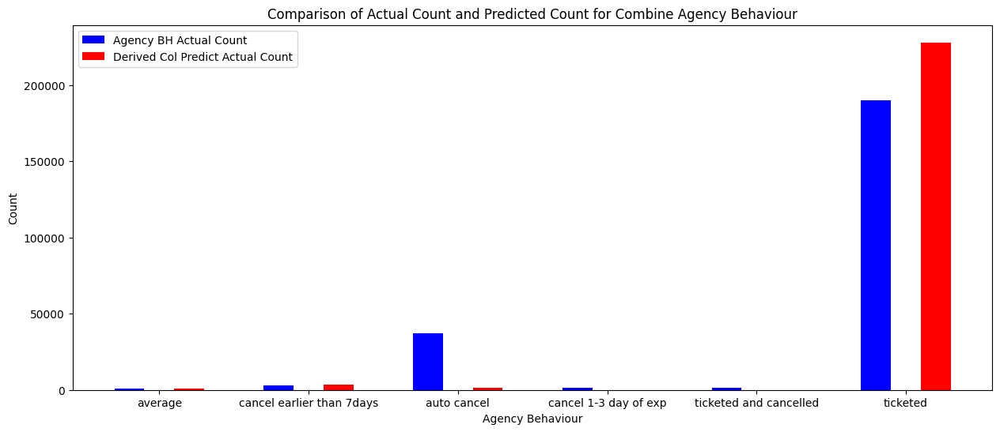

In [0]:
import matplotlib.pyplot as plt
import pandas as pd

# Convert Spark DataFrame to Pandas
pandas_df = df_resultant.toPandas()

# Set the figure size
plt.figure(figsize=(15, 6))

# Create a list of unique agency_behaviours
agency_behaviours = pandas_df['agency_behaviour'].unique()

# For each agency_behaviour, create a pair of bars
for i, agency_behaviour in enumerate(agency_behaviours):
    # Filter data for the current agency_behaviour
    data = pandas_df[pandas_df['agency_behaviour'] == agency_behaviour]
    
    # Create a pair of bars
    plt.bar(i - 0.2, data['agency_bh_actual_count'], 0.2, color='b')
    plt.bar(i + 0.2, data['derived_col_predict_actual_count'], 0.2, color='r')

# Set the x-ticks to be the agency_behaviours
plt.xticks(range(len(agency_behaviours)), agency_behaviours)

# Add labels and title
plt.xlabel('Agency Behaviour')
plt.ylabel('Count')
plt.title('Comparison of Actual Count and Predicted Count for Combine Agency Behaviour')
plt.legend(['Agency BH Actual Count', 'Derived Col Predict Actual Count'])

# Display the plot
plt.show()
